In [25]:
import pandas as pd
import plotly.graph_objects as go
import plotly.express as px
import plotly.io as pio
import missingno as msno
import re

In [ ]:
df = pd.read_csv('src/p2-arbres-fr.csv', sep=";")
json = pd.read_json('src/arrondissements.geojson')

In [2]:
df.columns

Index(['id', 'type_emplacement', 'domanialite', 'arrondissement',
       'complement_addresse', 'numero', 'lieu', 'id_emplacement',
       'libelle_francais', 'genre', 'espece', 'variete', 'circonference_cm',
       'hauteur_m', 'stade_developpement', 'remarquable', 'geo_point_2d_a',
       'geo_point_2d_b'],
      dtype='object')

In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 200137 entries, 0 to 200136
Data columns (total 18 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   id                   200137 non-null  int64  
 1   type_emplacement     200137 non-null  object 
 2   domanialite          200136 non-null  object 
 3   arrondissement       200137 non-null  object 
 4   complement_addresse  30902 non-null   object 
 5   numero               0 non-null       float64
 6   lieu                 200137 non-null  object 
 7   id_emplacement       200137 non-null  object 
 8   libelle_francais     198640 non-null  object 
 9   genre                200121 non-null  object 
 10  espece               198385 non-null  object 
 11  variete              36777 non-null   object 
 12  circonference_cm     200137 non-null  int64  
 13  hauteur_m            200137 non-null  int64  
 14  stade_developpement  132932 non-null  object 
 15  remarquable      

In [4]:
df.describe()

,id,numero,circonference_cm,hauteur_m,remarquable,geo_point_2d_a,geo_point_2d_b
count,2.001370e+05,0.0,200137.000000,200137.000000,137039.000000,200137.000000,200137.000000
mean,3.872027e+05,NaN,83.380479,13.110509,0.001343,48.854491,2.348208
std,5.456032e+05,NaN,673.190213,1971.217387,0.036618,0.030234,0.051220
min,9.987400e+04,NaN,0.000000,0.000000,0.000000,48.742290,2.210241
25%,1.559270e+05,NaN,30.000000,5.000000,0.000000,48.835021,2.307530
50%,2.210780e+05,NaN,70.000000,8.000000,0.000000,48.854162,2.351095
75%,2.741020e+05,NaN,115.000000,12.000000,0.000000,48.876447,2.386838
max,2.024745e+06,NaN,250255.000000,881818.000000,1.000000,48.911485,2.469759


In [5]:
df.head(5)

,id,type_emplacement,domanialite,arrondissement,complement_addresse,numero,lieu,id_emplacement,libelle_francais,genre,espece,variete,circonference_cm,hauteur_m,stade_developpement,remarquable,geo_point_2d_a,geo_point_2d_b
0,99874,Arbre,Jardin,PARIS 7E ARRDT,NaN,NaN,MAIRIE DU 7E 116 RUE DE GRENELLE PARIS 7E,19,Marronnier,Aesculus,hippocastanum,NaN,20,5,NaN,0.0,48.857620,2.320962
1,99875,Arbre,Jardin,PARIS 7E ARRDT,NaN,NaN,MAIRIE DU 7E 116 RUE DE GRENELLE PARIS 7E,20,If,Taxus,baccata,NaN,65,8,A,NaN,48.857656,2.321031
2,99876,Arbre,Jardin,PARIS 7E ARRDT,NaN,NaN,MAIRIE DU 7E 116 RUE DE GRENELLE PARIS 7E,21,If,Taxus,baccata,NaN,90,10,A,NaN,48.857705,2.321061
3,99877,Arbre,Jardin,PARIS 7E ARRDT,NaN,NaN,MAIRIE DU 7E 116 RUE DE GRENELLE PARIS 7E,22,Erable,Acer,negundo,NaN,60,8,A,NaN,48.857722,2.321006
4,99878,Arbre,Jardin,PARIS 17E ARRDT,NaN,NaN,PARC CLICHY-BATIGNOLLES-MARTIN LUTHER KING,000G0037,Arbre à miel,Tetradium,daniellii,NaN,38,0,NaN,NaN,48.890435,2.315289


<AxesSubplot:>

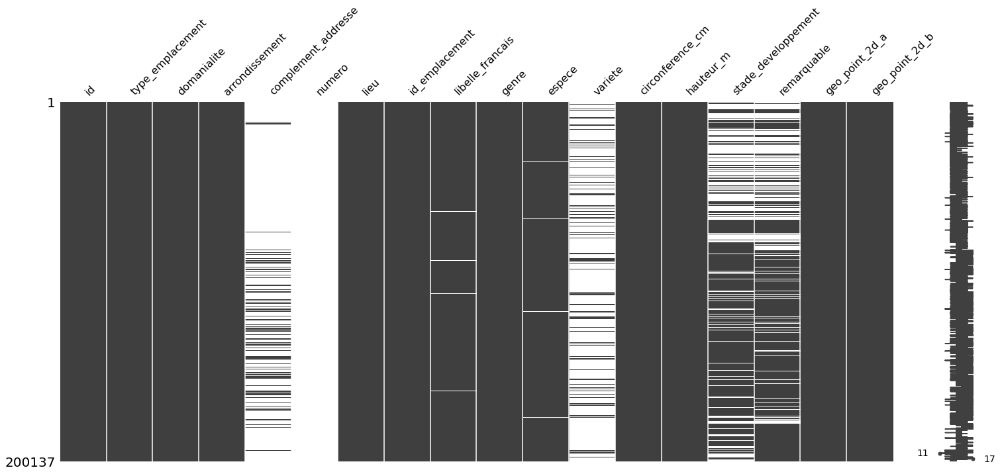

In [6]:
msno.matrix(df)

<AxesSubplot:>

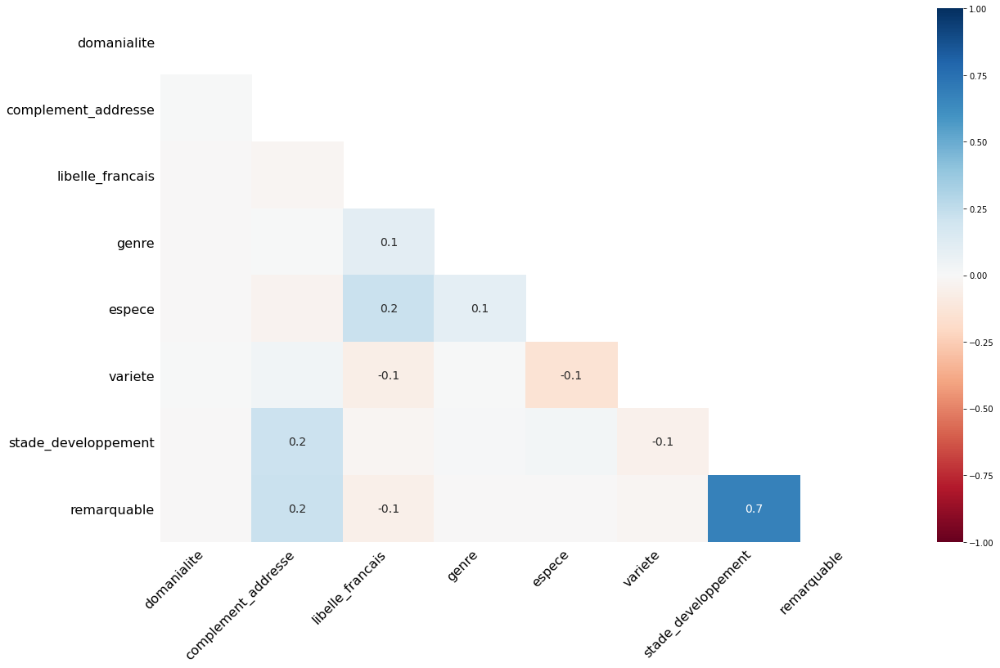

In [7]:
msno.heatmap(df)

In [8]:
df.isnull().mean() * 100

id                       0.000000
type_emplacement         0.000000
domanialite              0.000500
arrondissement           0.000000
complement_addresse     84.559577
numero                 100.000000
lieu                     0.000000
id_emplacement           0.000000
libelle_francais         0.747988
genre                    0.007995
espece                   0.875400
variete                 81.624088
circonference_cm         0.000000
hauteur_m                0.000000
stade_developpement     33.579498
remarquable             31.527404
geo_point_2d_a           0.000000
geo_point_2d_b           0.000000
dtype: float64

In [9]:
df = df.drop(columns=['complement_addresse','numero', 'variete'])

In [10]:
df.head()

,id,type_emplacement,domanialite,arrondissement,lieu,id_emplacement,libelle_francais,genre,espece,circonference_cm,hauteur_m,stade_developpement,remarquable,geo_point_2d_a,geo_point_2d_b
0,99874,Arbre,Jardin,PARIS 7E ARRDT,MAIRIE DU 7E 116 RUE DE GRENELLE PARIS 7E,19,Marronnier,Aesculus,hippocastanum,20,5,NaN,0.0,48.857620,2.320962
1,99875,Arbre,Jardin,PARIS 7E ARRDT,MAIRIE DU 7E 116 RUE DE GRENELLE PARIS 7E,20,If,Taxus,baccata,65,8,A,NaN,48.857656,2.321031
2,99876,Arbre,Jardin,PARIS 7E ARRDT,MAIRIE DU 7E 116 RUE DE GRENELLE PARIS 7E,21,If,Taxus,baccata,90,10,A,NaN,48.857705,2.321061
3,99877,Arbre,Jardin,PARIS 7E ARRDT,MAIRIE DU 7E 116 RUE DE GRENELLE PARIS 7E,22,Erable,Acer,negundo,60,8,A,NaN,48.857722,2.321006
4,99878,Arbre,Jardin,PARIS 17E ARRDT,PARC CLICHY-BATIGNOLLES-MARTIN LUTHER KING,000G0037,Arbre à miel,Tetradium,daniellii,38,0,NaN,NaN,48.890435,2.315289


In [11]:
fig = go.Figure()
fig.add_trace(go.Box(y=df['hauteur_m'], name="Hauteur"))
fig.add_trace(go.Box(y=df['circonference_cm'], name="Circonférence"))
fig.update_yaxes(type="log")


fig.show()

In [12]:
df.drop(df[df['hauteur_m'] > 37].index, inplace=True)
df.drop(df[df['hauteur_m'] == 0].index, inplace=True)
df.drop(df[df['circonference_cm'] > 470].index, inplace=True)
df.drop(df[df['circonference_cm'] == 0].index, inplace=True)

In [13]:
fig = go.Figure()
fig.add_trace(go.Box(y=df['hauteur_m'], name="Hauteur"))
fig.add_trace(go.Box(y=df['circonference_cm'], name="Circonférence"))
fig.update_yaxes(type="log")


fig.show()

In [21]:
df.drop(df[df['arrondissement'] == 'HAUTS-DE-SEINE'].index, inplace=True)
df.drop(df[df['arrondissement'] == 'SEINE-SAINT-DENIS'].index, inplace=True)
df.drop(df[df['arrondissement'] == 'VAL-DE-MARNE'].index, inplace=True)

df.replace(to_replace={"arrondissement": {"BOIS DE BOULOGNE": "PARIS 16E ARRDT", "BOIS DE VINCENNES": "PARIS 12E ARRDT"}}, value=None, inplace=True)

In [22]:
count = df.groupby(['arrondissement'])['id'].count().reset_index()
print(count)

     arrondissement     id
0   PARIS 10E ARRDT   3104
1   PARIS 11E ARRDT   5479
2   PARIS 12E ARRDT  20154
3   PARIS 13E ARRDT  13564
4   PARIS 14E ARRDT  11331
5   PARIS 15E ARRDT  11418
6   PARIS 16E ARRDT  18264
7   PARIS 17E ARRDT   8651
8   PARIS 18E ARRDT   8413
9   PARIS 19E ARRDT  10278
10  PARIS 1ER ARRDT   1333
11  PARIS 20E ARRDT  12898
12   PARIS 2E ARRDT    534
13   PARIS 3E ARRDT   1200
14   PARIS 4E ARRDT   2684
15   PARIS 5E ARRDT   2257
16   PARIS 6E ARRDT   1739
17   PARIS 7E ARRDT   8409
18   PARIS 8E ARRDT   7025
19   PARIS 9E ARRDT   1098


In [18]:
data=[dict(
    type = 'histogram',
    x = df['arrondissement'],
    y = df['id'],
    transforms = [dict(
        type = 'count',
        groups = df['arrondissement'],
        aggregations = [dict(
            target = 'y', func = 'count', enabled = True)
        ]
    )]
)]

layout = dict(
    title = 'Arbres par arrondissement',
    xaxis = dict(title='Arrondissement'),
    yaxis = dict(title='Nombre d\'arbres')
)

fig_dict = dict(data = data, layout = layout)
pio.show(fig_dict, validate=False)

In [19]:
df_surface = pd.DataFrame({
    "arrondissement" : [arr["properties"]["c_ar"] for arr in json["features"]], 
    "surface" : [arr["properties"]["surface"] for arr in json["features"]],
    "geoloc_a" : [arr["properties"]["geom_x_y"][0] for arr in json["features"]],
    "geoloc_b" : [arr["properties"]["geom_x_y"][1] for arr in json["features"]]
})
df_surface

,arrondissement,surface,geoloc_a,geoloc_b
0,14,5.614877e+06,48.829245,2.326542
1,20,5.983446e+06,48.863461,2.401188
2,16,1.637254e+07,48.860392,2.261971
3,19,6.792651e+06,48.887076,2.384821
4,5,2.539375e+06,48.844443,2.350715
5,1,1.824613e+06,48.862563,2.336443
6,7,4.090057e+06,48.856174,2.312188
7,8,3.880036e+06,48.872721,2.312554
8,13,7.149311e+06,48.828388,2.362272
9,17,5.668835e+06,48.887327,2.306777


In [23]:
count.rename(columns={'id': 'arbre'}, inplace=True)
count

,arrondissement,arbre
0,PARIS 10E ARRDT,3104
1,PARIS 11E ARRDT,5479
2,PARIS 12E ARRDT,20154
3,PARIS 13E ARRDT,13564
4,PARIS 14E ARRDT,11331
5,PARIS 15E ARRDT,11418
6,PARIS 16E ARRDT,18264
7,PARIS 17E ARRDT,8651
8,PARIS 18E ARRDT,8413
9,PARIS 19E ARRDT,10278


In [26]:
l_arr = []
for i in range(0, count.shape[0]):
    res = re.search(r"[0-9]+", count["arrondissement"][i])
    if res :
        l_arr.append(int(res[0]))

In [27]:
count["arrondissement"] = l_arr
count

,arrondissement,arbre
0,10,3104
1,11,5479
2,12,20154
3,13,13564
4,14,11331
5,15,11418
6,16,18264
7,17,8651
8,18,8413
9,19,10278


In [28]:
df_surface = df_surface.merge(count, on="arrondissement")

In [29]:
df_surface["arbre_par_surface"] = df_surface["arbre"]/df_surface["surface"]

In [30]:
px.set_mapbox_access_token("pk.eyJ1Ijoia2l3aWhhY2tzeW91IiwiYSI6ImNrdXNjamFsZTE2NG8ybnM3dnNkbDUzbm0ifQ.6lfpJUFCsVVnPJkG7yi5cg")
map_scatter_fig = px.scatter_mapbox(df_surface, lat="geoloc_a", lon="geoloc_b", size="arbre", zoom=11, color="arbre", hover_name="arrondissement")
map_scatter_fig.show()